In [1]:
# check installed version
import pycaret
pycaret.__version__

'3.3.2'

## **Task 1: Exploratory Data Analysis**

**Importing necessary data libraries**


In [2]:
# Libraries to help with reading and manipulating data
import numpy as np
import pandas as pd

# Libraries to help with data visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Current version of Seaborn generates a bunch of warni|ngs that we'll ignore in this tutorial
import warnings
warnings.filterwarnings("ignore")

# Command to tell Python to actually display the graphs
%matplotlib inline
sns.set()

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)

**Load in the Dataset**

In [7]:
df = pd.read_csv('../data/03_transaction_records.csv')
df.head()

,FISCAL_YR,FISCAL_MTH,DEPT_NAME,DIV_NAME,MERCHANT,CAT_DESC,TRANS_DT,AMT
0,2017,1,DEPT OF EDUCATION,DEPARTMENT OF EDUCATION,DOUBLETREE HOTELS WASHING,LODGING,6/3/2016,-5.50
1,2017,1,DEPT OF EDUCATION,DEPARTMENT OF EDUCATION,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,6/26/2016,18.31
2,2017,1,DEPT OF EDUCATION,DEPARTMENT OF EDUCATION,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,6/26/2016,21.61
3,2017,1,DEPT OF EDUCATION,DEPARTMENT OF EDUCATION,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,6/26/2016,22.39
4,2017,1,DEPT OF EDUCATION,DEPARTMENT OF EDUCATION,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,6/26/2016,5.44


**Print Basic Info of the Dataset**

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15156 entries, 0 to 15155
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   FISCAL_YR   15156 non-null  int64  
 1   FISCAL_MTH  15156 non-null  int64  
 2   DEPT_NAME   15156 non-null  object 
 3   DIV_NAME    15156 non-null  object 
 4   MERCHANT    15156 non-null  object 
 5   CAT_DESC    15156 non-null  object 
 6   TRANS_DT    15156 non-null  object 
 7   AMT         15156 non-null  float64
dtypes: float64(1), int64(2), object(5)
memory usage: 947.4+ KB


Based on this information we can infer:
- number of columns = 8, number of rows = 15156
- 2 int64 columns, 5 object columns, 1 float64 column
- all columns have 15156 non-null values, which suggest that this dataset does not contain any nulls
- TRANS_DT, a column that contains the transaction date needs to be converted to a datetime object

**Display Summary of Numerical Columns**

In [5]:
df.describe()

,FISCAL_YR,FISCAL_MTH,AMT
count,15156.000000,15156.000000,15156.000000
mean,2019.156374,6.293019,315.448271
std,1.661039,3.542863,1530.714012
min,2017.000000,1.000000,-12849.300000
25%,2018.000000,3.000000,16.090000
50%,2019.000000,6.000000,48.990000
75%,2021.000000,10.000000,264.162500
max,2022.000000,12.000000,88501.320000


FISCAL_YR:
- earliest FISCAL_YR recorded is 2017
- 25% of data points fall before or during 2018
- 50% of data points fall before or during 2019
- 75% of data points fall before or during 2021
- latest FISCAL_YR recorded is 2022

FISCAL_MTH
- earliest FISCAL_MTH recorded is 1 
- 25% of data points fall before or during 3 
- 50% of data points fall before or during 6 
- 75% of data points fall before or during 10 
- latest FISCAL_MTH recorded is 12 

AMT
- mean expense is 315.44
- high std of 1530.71, suggesting a lot variation in the data, suggesting the presence of extremely high outlier values
- min value is -12849.30, suggesting presence of errors
- 25% of data points fall below or equal to 16.09
- 50% of data points fall below or equal to 48.99
- 75% of data points fall below or equal to 264.16
- highest AMT value recorded is 88501.32, which is very far from the 75th percentile, suggesting presence of extremely high outlier values

**Check for Duplicated Values**

In [6]:
df.duplicated().sum()

484

It can be inferred that we need to remove these 484 duplicated values. Leaving duplicated values in the dataset when doing anomaly detection can cause some problems for our model:
- duplicates may mislead the model, as the model may take these duplicate values as patterns rather than anomalies that it needs to detect
- duplicates can introduce noise to the dataset
- duplicates may cause the model to be overfitted

**Drop these Duplicated Values**

In [7]:
df = df.drop_duplicates()
df.duplicated().sum()

0

**Amount of Expense Against Fiscal Year and Fiscal Month**

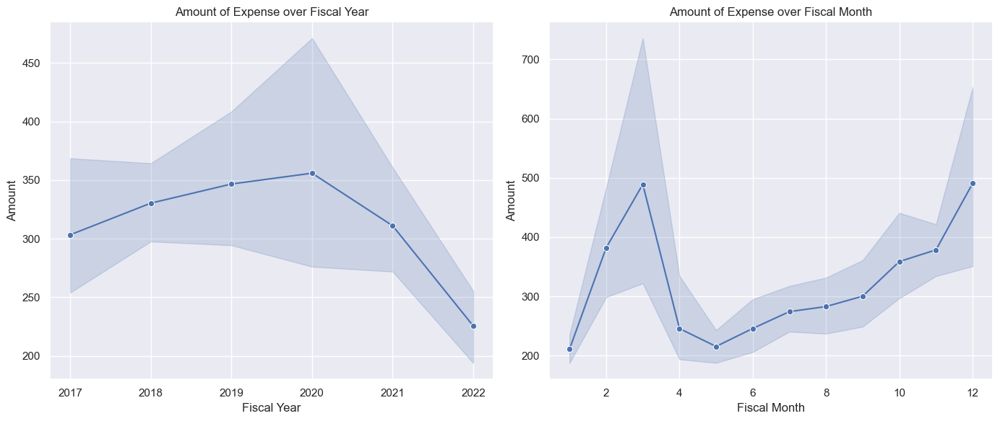

In [8]:
#create subplot grid so that the charts can go side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

#distribution plot on the left
sns.lineplot(x=df['FISCAL_YR'], y=df['AMT'], ax=ax1, marker='o')
ax1.set_title('Amount of Expense over Fiscal Year')
ax1.set_xlabel('Fiscal Year')
ax1.set_ylabel('Amount')

#box plot on the right
sns.lineplot(x=df['FISCAL_MTH'], y=df['AMT'], ax=ax2, marker='o')
ax2.set_title('Amount of Expense over Fiscal Month')
ax2.set_xlabel('Fiscal Month')
ax2.set_ylabel('Amount')

#adjust the spacing
plt.tight_layout()
plt.show()

Amount of expense over Fiscal Year
- trend gradually increases from 300 in 2017 to 350 in 2020
- trend drops from 350 in 2020 to 225 in 2022
- this drop may be attributed to covid-19, which disrupted the operations of many businesses
- hence, many businesses had to reduce their expenses due to reduced operations

Amount of expense over Fiscal Month
- expense peaks on the 3rd month, and drop immediately
    - this may suggest seasonal trends at play, where business operations become more expensive during the 3rd fiscal month
- expense gradually increases from around 200 during the 5th month to around 500 during the 12th month


**Distribution of Amount**

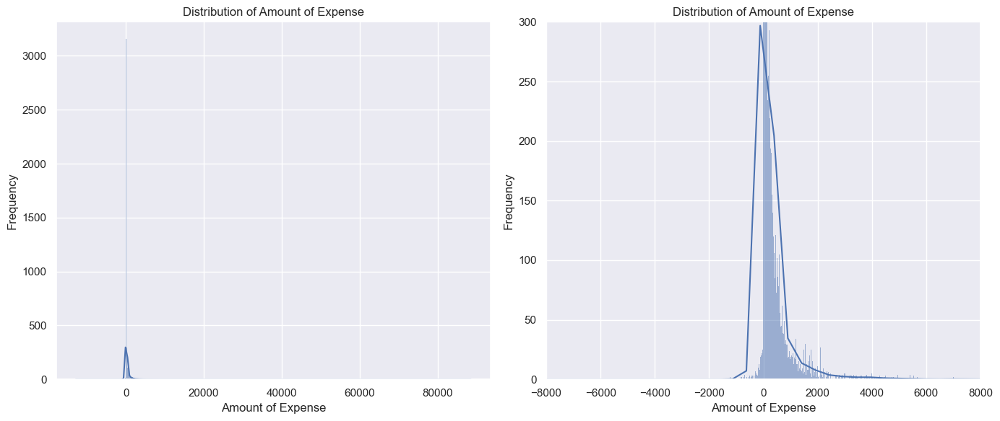

In [9]:
#create subplot grid so that the charts can go side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

#distribution plot on the left
sns.histplot(df['AMT'], kde=True, ax=ax1)
ax1.set_title('Distribution of Amount of Expense')
ax1.set_xlabel('Amount of Expense')
ax1.set_ylabel('Frequency')

#box plot on the right
sns.histplot(df['AMT'], kde=True, ax=ax2)
ax2.set_title('Distribution of Amount of Expense')
ax2.set_xlabel('Amount of Expense')
ax2.set_ylabel('Frequency')
ax2.set_xlim(-8000, 8000)
ax2.set_ylim(0, 300)

#adjust the spacing
plt.tight_layout()
plt.show()

Left plot has no axis limits set, it visualises the true distribution of the AMT column
- however, due to extremely high outliers for the frequency of AMT and extremely high outliers for the value of AMT, the main distribution has been compressed to a very tiny curve
- through this plot, it can be inferred that these are the outliers that need to be detected through the anomaly detection model

Right plot has axis limits set, it visualises the main range of the AMT column (excluding the extreme outliers)
- you can see that the curve has a longer right tail, suggesting that it is right-skewed or positive skewed
    - this suggests that the data points are generally scattered towards the left of the graph (generally, lower values of AMT)
    - while there are fewer instances of larger values scattered towards the right of the graph (less instances of higher values of AMT)
- you can see an extremely sharp peak, suggesting that data points generally centre around the mean
    - suggesting heavier tails due to a high concentration of extreme values in tails.

In [10]:
skewness = df['AMT'].skew()
kurtosis = df['AMT'].kurt()
print('Distribution Metrics for Amount of Expense')
print('********************************************')
print('Skewness of AMT:', skewness)
print('Kurtosis of AMT:', kurtosis)

Distribution Metrics for Amount of Expense
********************************************
Skewness of AMT: 31.122618373981798
Kurtosis of AMT: 1338.3352339830033


Skewness:
- It can be seen that the AMT column has a very high, positive skew at 31.57.
- The AMT column is right-skewed, and that its mean > median > mode.
- Can be related back to the charts above.

Kurtosis:
- The kurtosis is 1378.99, and is greater than 3.
- Hence, AMT has a leptokurtic distribution.
- This tells us that there is a sharp peak around the mean, indicating that a large number of AMT expenses center around the mean.
- Also tells us that there are heavier tails, meaning that there are more outliers present in the dataset.



**Analysing DEPT_NAME**

In [11]:
df['DEPT_NAME'].value_counts()

DEPT_NAME
DEPT OF EDUCATION    14672
Name: count, dtype: int64

Since there is no variation in this column, we can just igore it as it is not meaningful for our analysis.

**Analysing DIV_NAME**

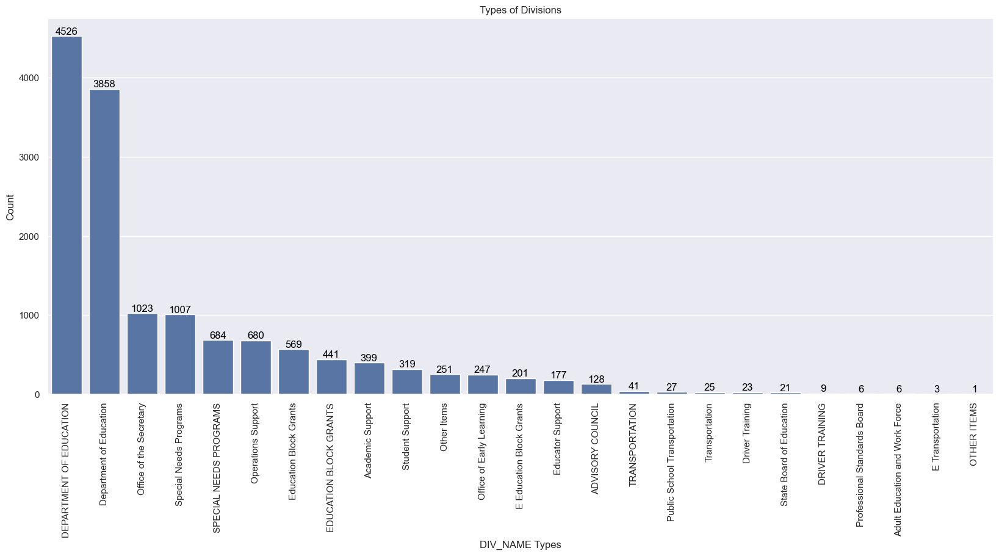

In [12]:
plt.figure(figsize=(20, 8))
divnames = df['DIV_NAME'].value_counts()
ax = sns.barplot(x = divnames.index, y=divnames.values)
plt.xlabel('DIV_NAME Types')
plt.ylabel('Count')
plt.title('Types of Divisions')
#add text annotations on each bar
for column, count in enumerate(divnames):
    ax.text(column, count, f'{count}', ha='center',va='bottom',fontsize=12, color='black')
ax.tick_params(axis='x',labelrotation=90)
plt.show()

Based on the barplot above, it is evident that the department of education makes up for majority of records (4675). Additionally, you can also see that the naming conventions are not standardise. For example:
- DEPARTMENT OF EDUCATION vs Department of Education
- SPECIAL NEEDS PROGRAMS vs Special Needs Programs  

As such, this barplot may mislead viewers into thinking there are many divisions. To correct this, naming conventions of the divisons can be standardised in the data cleaning portion.

**Standardising Naming Conventions for DIV_NAME**  

In [13]:
df['DIV_NAME'].replace({'DEPARTMENT OF EDUCATION': 'Department of Education',
                                         'SPECIAL NEEDS PROGRAMS': 'Special Needs Programs',
                                         'EDUCATION BLOCK GRANTS': 'Education Block Grants',
                                         'E Education Block Grants': 'Education Block Grants',
                                         'OTHER ITEMS': 'Other Items',
                                         'ADVISORY COUNCIL': 'Advisory Council',
                                         'TRANSPORTATION': 'Transportation',
                                         'E Transportation': 'Transportation',
                                         'DRIVER TRAINING': 'Driver Training'}, inplace=True)

In [14]:
df['DIV_NAME'].value_counts()

DIV_NAME
Department of Education           8384
Special Needs Programs            1691
Education Block Grants            1211
Office of the Secretary           1023
Operations Support                 680
Academic Support                   399
Student Support                    319
Other Items                        252
Office of Early Learning           247
Educator Support                   177
Advisory Council                   128
Transportation                      69
Driver Training                     32
Public School Transportation        27
State Board of Education            21
Professional Standards Board         6
Adult Education and Work Force       6
Name: count, dtype: int64

Here, you can see that the naming conventions of the divisons are now standardised. This is important as it allows for:
- uniform representation of data
- avoiding redundancy
- better comparison of values
- reducing model complexity

**Analysing MERCHANT**

In [15]:
df['MERCHANT'].nunique()

5802

In [19]:
df['MERCHANT'].value_counts()

MERCHANT
WB MASON                         291
AMAZON.COM                       204
VZWRLSS*IVR VB                   166
AMAZON MKTPLACE PMTS             160
USPS PO 0917600901               156
PATS PIZZA IN WEST DOVER         137
SHOPRITE CHRSTNLNDG S1           126
DMI* DELL HLTHCR/REL             121
XEROX CORPORATION/RBO            109
NCS*GED EXAM                      86
IDU*INSIGHT PUBLIC SEC            80
PPA PHL AIRPORT                   64
USPS 09082005335430727            62
COMCAST                           59
STAPLES DIRECT                    59
SSI*SCHOOL SPECIALTY              59
DMI* DELL K-12/GOVT               59
WW GRAINGER                       58
UBER TRIP                         57
SCHOOL NUTRITION ASSOC            56
FOOD LION #1385                   54
MHE*MCGRAW-HILL ECOMM             54
CAPRIOTTI'S SANDWI                53
TC *STATIONERY HOUSE              53
UPS*000021X956                    50
USPS 09176009035400373            50
RESTAURANT DEPOT             

Since there are 5802 unqiue values of MERCHANT names, we can infer that this column has high cardinality. Additionally, some of these values are rare where the lowest number of occurrence is 1. These rare categories can cause the machine learning model to be overfitted because they do not provide much information. Hence, we will be using the rare_to_value parameter in the setup function.

**Analysing CAT_DESC**

In [20]:
df['CAT_DESC'].nunique()

208

In [21]:
df['CAT_DESC'].value_counts()

CAT_DESC
Eating Places Restaurants                             1519
EATING PLACES RESTAURANTS                              960
Stationery-Office Supplies-Printing Writing Pap        904
Lodging                                                770
Airline                                                601
STATIONERY-OFFICE SUPPLIES-PRINTING WRITING PAP        576
LODGING                                                529
Fast Food Restaurants                                  521
FAST FOOD RESTAURANTS                                  436
Travel                                                 385
AIRLINE                                                335
Book Stores                                            328
Grocery Stores Supermarkets                            265
BOOK STORES                                            247
Schools Educational Svc-Not Elsewhere Classified       237
Business Services-Not Elsewhere Classified             227
Automobile Parking Lots And Garages            

Since there are 208 unqiue values of MERCHANT names, we can infer that this column has high cardinality. Additionally, some of these values are rare where the lowest number of occurrence is 1. These rare categories can cause the machine learning model to be overfitted because they do not provide much information. Hence, we will be using the rare_to_value parameter in the setup function.

**Analysing MERCHANT by AMT**

In [22]:
#group by merchant and calculate the total amt per merchant
top_merchants = df.groupby('MERCHANT')['AMT'].sum().sort_values(ascending=False).head(10)
top_merchants

MERCHANT
DMI* DELL K-12/GOVT         306398.97
IDU*INSIGHT PUBLIC SEC      166064.33
DMI* DELL HLTHCR/REL        165820.60
NCS*GED EXAM                106360.00
CAREER CRUISING              95000.00
AMAZON.COM                   85085.59
PAYPAL *THISISLANG           83600.00
VZWRLSS*IVR VB               80427.97
WB MASON                     58799.30
MICROSOFT - 31 SAN FRANC     51743.13
Name: AMT, dtype: float64

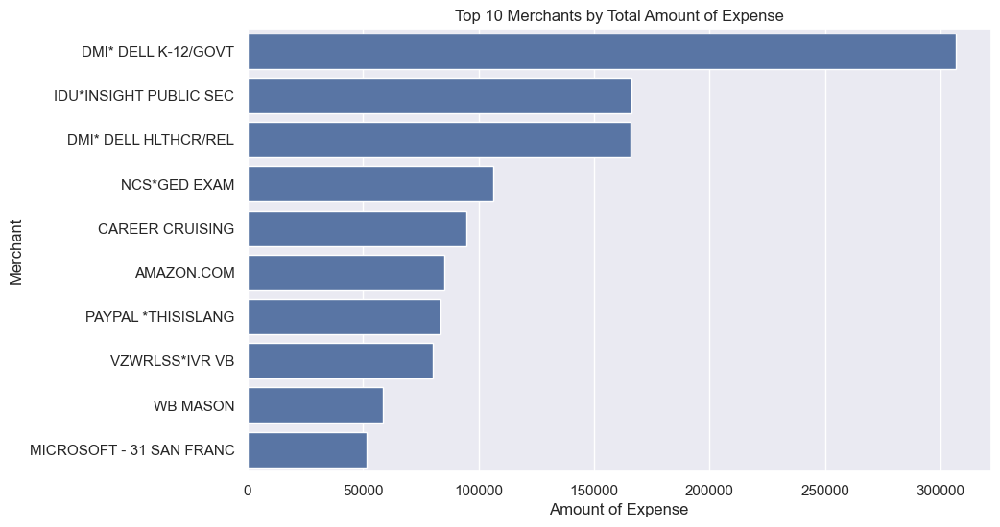

In [23]:
#plot the chart
plt.figure(figsize=(10, 6))
sns.barplot(x=top_merchants.values, y=top_merchants.index)
plt.title('Top 10 Merchants by Total Amount of Expense')
plt.xlabel('Amount of Expense')
plt.ylabel('Merchant')
plt.show()

This chart shows the top 10 merchants that have the highest total amount of expense
- DMI* DELL K-12/GOVT is the top 1 biggest merchant with the highest total amount of expense at about 300,000
- MICROSOFT - 31 SAN FRANC is the top 10 biggest merchant with a total amount of expense at about 50,000

**Converting TRANS_DT to Datetime object**

In [24]:
df['TRANS_DT'] = pd.to_datetime(df['TRANS_DT'], format='%m/%d/%Y', errors='coerce')

In [25]:
df['TRANS_DT'].isnull().sum()

4

In [26]:
df.dropna(inplace=True)

In [27]:
df['TRANS_DT'].isnull().sum()

0

**Setting Aside an Unseen Set for Testing**

In [28]:
unseen_df = df.sample(frac=0.05, random_state=42)
df = df.drop(unseen_df.index).reset_index(drop=True)

In [29]:
unseen_df = unseen_df.reset_index(drop=True)
print('Dataset used for training and validating model:',df.shape)
print('Dataset used for testing model:',unseen_df.shape)

Dataset used for training and validating model: (13935, 8)
Dataset used for testing model: (733, 8)


## **Task 2: Develop ML Pipeline Using PyCaret**

**Part 1: Initialise Setup Function with Preprocessing Tasks**

In [30]:
import mlflow

mlflow.set_tracking_uri("http://127.0.0.1:5000")

In [31]:
from pycaret.anomaly import *

s = setup(data=df, 
          categorical_features=['DIV_NAME', 'MERCHANT', 'CAT_DESC'], 
          ignore_features=['DEPT_NAME'], #ignore this feature as it is not meaningful for prediction
          normalize=True,
          normalize_method='robust', #using a robust scaler as it is more robust to outliers 
          rare_to_value=0.1, #convert rare values for merchant and cat_desc 
          log_experiment = True,
          log_plots = True,
          experiment_name = 'anomaly_detection',
          session_id=123)

,Description,Value
0,Session id,123
1,Original data shape,"(13935, 8)"
2,Transformed data shape,"(13935, 11)"
3,Ignore features,1
4,Numeric features,3
5,Date features,1
6,Categorical features,3
7,Preprocess,True
8,Imputation type,simple
9,Numeric imputation,mean


2024/08/24 15:33:09 INFO mlflow.tracking.fluent: Experiment with name 'anomaly_detection' does not exist. Creating a new experiment.


**Part 2 & 3: Train and Evaluate Models**

In [32]:
models()

,Name,Reference
ID,,
abod,Angle-base Outlier Detection,pyod.models.abod.ABOD
cluster,Clustering-Based Local Outlier,pycaret.internal.patches.pyod.CBLOFForceToDouble
cof,Connectivity-Based Local Outlier,pyod.models.cof.COF
iforest,Isolation Forest,pyod.models.iforest.IForest
histogram,Histogram-based Outlier Detection,pyod.models.hbos.HBOS
knn,K-Nearest Neighbors Detector,pyod.models.knn.KNN
lof,Local Outlier Factor,pyod.models.lof.LOF
svm,One-class SVM detector,pyod.models.ocsvm.OCSVM
pca,Principal Component Analysis,pyod.models.pca.PCA


In this section, we will only shortlist 4 main models that are most suitable for predicting anomalies in our dataset. These are:
- iforest
    - does not assume distribution of data, making it flexible
    - isolates anomalies using binary trees
- knn
    - works on the idea that, if the data point lies close to its neighbors, it belongs to the same cluster
    - if the data point lies far from its neighbors, it is classified as an outlier
    - easy to interpret
- lof
    - good at identifying outliers by comparing the local density of a data point to that of its neighbors
    - works on the idea that, if the local density of the data point is similar to its neighbors, it belongs to the same cluster
    - if the data point’s local density is lower than its neighbors, it is classified as an outlier
- pca
    - good for detecting anomalies based on how much a data point deviates from the principal components of the data
    - highlights unusual patterns

In [33]:
#train the 4 different models
iforest = create_model('iforest')
knn = create_model('knn')
lof = create_model('lof')
pca = create_model('pca')

#assign the 4 models
iforest_results = assign_model(iforest)
knn_results = assign_model(knn)
lof_results = assign_model(lof)
pca_results = assign_model(pca)


In [34]:
iforest_results.head()

,FISCAL_YR,FISCAL_MTH,DIV_NAME,MERCHANT,CAT_DESC,TRANS_DT,AMT,Anomaly,Anomaly_Score
0,2017,1,Department of Education,DOUBLETREE HOTELS WASHING,LODGING,2016-06-03,-5.500000,0,-0.061642
1,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,18.309999,0,-0.102084
2,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,21.610001,0,-0.102084
3,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,22.389999,0,-0.102084
4,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,5.440000,0,-0.102084


In [35]:
knn_results.head()

,FISCAL_YR,FISCAL_MTH,DIV_NAME,MERCHANT,CAT_DESC,TRANS_DT,AMT,Anomaly,Anomaly_Score
0,2017,1,Department of Education,DOUBLETREE HOTELS WASHING,LODGING,2016-06-03,-5.500000,0,0.200252
1,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,18.309999,0,0.051972
2,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,21.610001,0,0.044662
3,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,22.389999,0,0.041513
4,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,5.440000,0,0.069394


In [36]:
lof_results.head()

,FISCAL_YR,FISCAL_MTH,DIV_NAME,MERCHANT,CAT_DESC,TRANS_DT,AMT,Anomaly,Anomaly_Score
0,2017,1,Department of Education,DOUBLETREE HOTELS WASHING,LODGING,2016-06-03,-5.500000,0,1.317123
1,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,18.309999,0,1.037141
2,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,21.610001,0,1.038278
3,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,22.389999,0,1.038868
4,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,5.440000,0,1.046331


In [37]:
pca_results.head()

,FISCAL_YR,FISCAL_MTH,DIV_NAME,MERCHANT,CAT_DESC,TRANS_DT,AMT,Anomaly,Anomaly_Score
0,2017,1,Department of Education,DOUBLETREE HOTELS WASHING,LODGING,2016-06-03,-5.500000,0,7.669560e+37
1,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,18.309999,0,7.463571e+37
2,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,21.610001,0,7.463287e+37
3,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,22.389999,0,7.463220e+37
4,2017,1,Department of Education,HYATT REGENCY NW ORLE F/B,EATING PLACES RESTAURANTS,2016-06-26,5.440000,0,7.464709e+37


All 4 models predicted the first 5 rows of the dataset to have 0 anomalies. However, this is not conclusive enough as we are only comparing the first 5 rows, since it would be inefficient to compare all rows manually. Hence, in the next section we will be using plots the understand patterns and clusters that the models have identified.

In [38]:
#only include anomalies that have been flagged by all 4 models
iforest_anomaly = iforest_results[iforest_results['Anomaly']==1]
knn_anomaly = knn_results[knn_results['Anomaly']==1]
lof_anomaly = lof_results[lof_results['Anomaly']==1]
pca_anomaly = pca_results[pca_results['Anomaly']==1]

print('iforest:',iforest_anomaly.shape)
print('knn:',knn_anomaly.shape)
print('lof:',lof_anomaly.shape)
print('pca:',pca_anomaly.shape)

iforest: (697, 9)
knn: (697, 9)
lof: (697, 9)
pca: (697, 9)


**Evaluating iforest model**

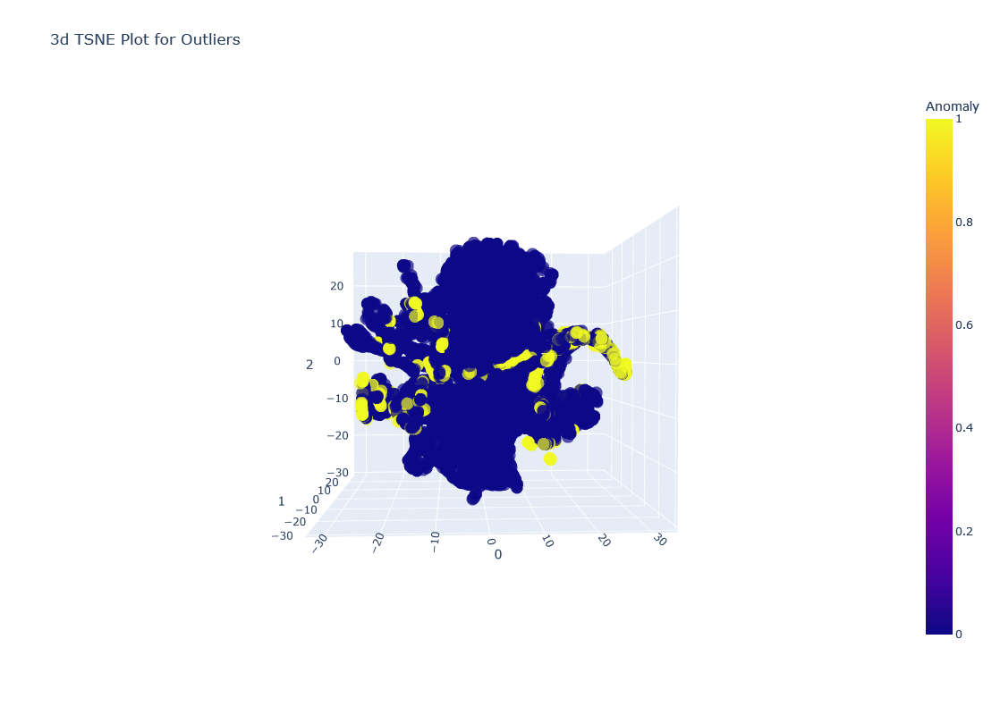

In [39]:
plot_model(iforest, plot = 'tsne')

Based on the plot above, you can see that there is:
- a dense cluster (blue) which is sandwiched between the yellow data points (outliers)
- a cluster of anomalies on both the left and right of the dense cluster
- some overlapping of anomaly data points and non-anomaly data points

Overall, there seems to be clusters where the anomalies are located as they are not scattered randomly across the plot.

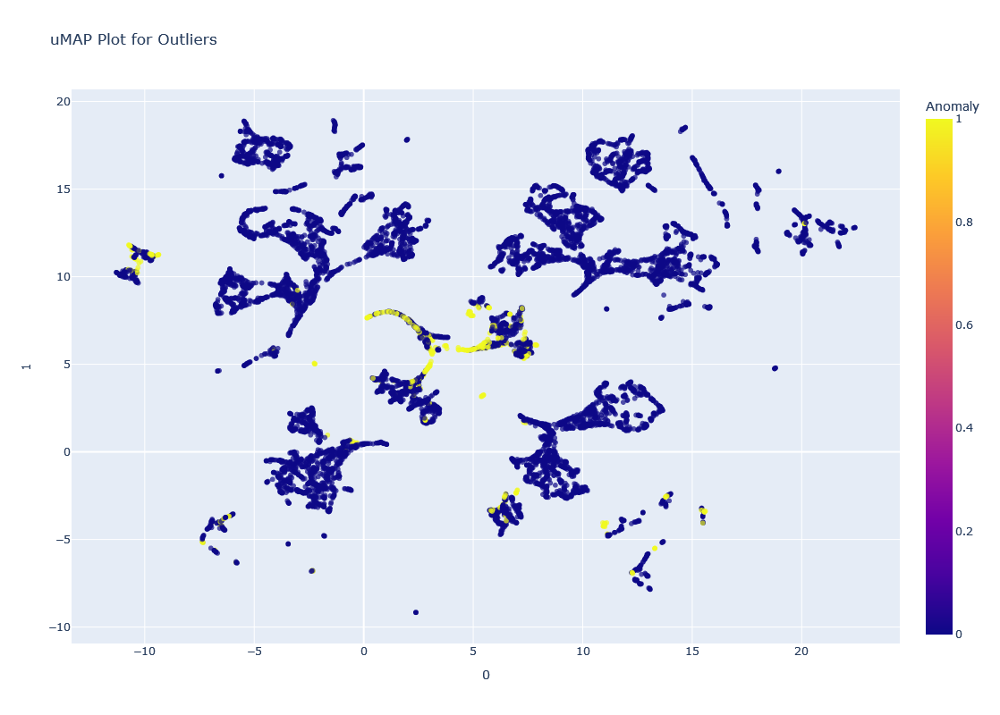

In [40]:
plot_model(iforest, plot = 'umap')

From the umap, it is evident that there are:
- distinct clusters of data points
- anomalies (yellow data points) are mostly contained in their own clusters with some overlapping with the blue data points
- there is low noise present when detecting the anomalies as most data points fall within clear clusters
- some overlapping in anomalies and non-anomaly points
- detected anomalies in the centre of the plot
- detected anomalies scattered at the left of the plot
- detected anomalies scattered at the bottom right of the plot

Overall, the iforest model performs well in detecting anomalies based on the 3d-TSNE and UMAP plots.

**Evaluating KNN model**

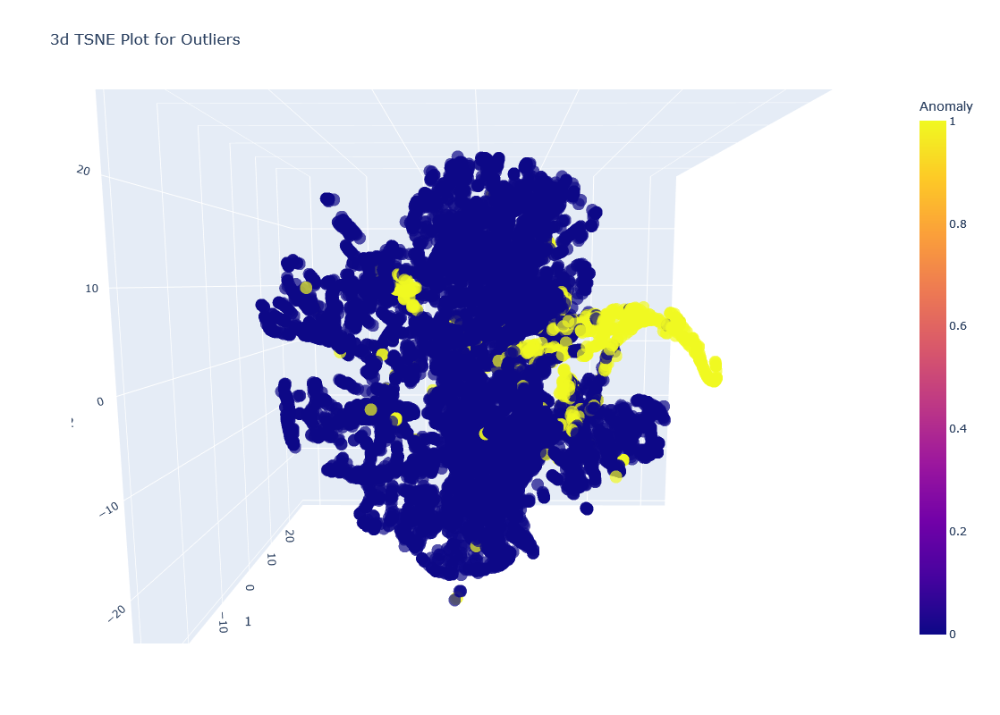

In [41]:
plot_model(knn, plot = 'tsne')

Based on the plot above, you can see that there is:
- a dense cluster (blue)
- a stretch of yellow data points (outliers) exetending outwards to the right
- detected less anomalies than the iforest model on the left of the plot

Overall, there seems to be a cluster where the anomalies are located as they are not scattered randomly across the plot.

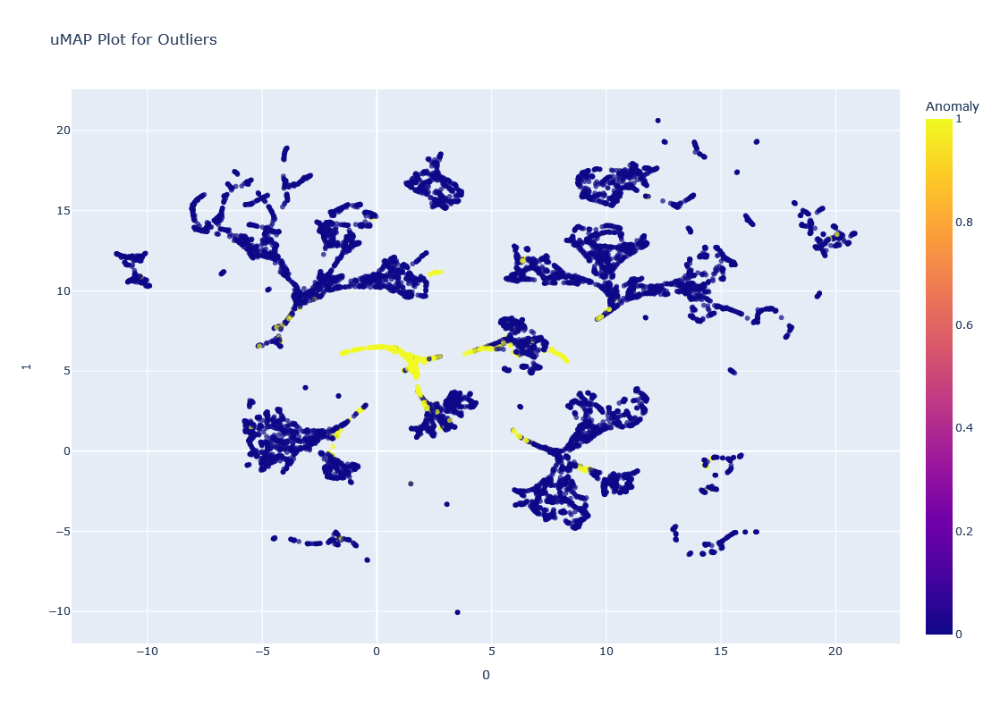

In [42]:
plot_model(knn, plot = 'umap')

From the umap, it is evident that there are:
- distinct clusters of data points
- anomalies (yellow data points) are mostly contained in their own clusters where they do not really mix with the blue data points
- there is low noise present when detecting the anomalies as most data points fall within clear clusters
- less overlapping of yellow (anomalies) and blue data points (non-anomalies) than iforest model
- detected similar, but more anomalies in the centre of the chart than the iforest model  
  
Overall, the knn model performs relatively well in detecting anomalies based on the 3d-TSNE and UMAP plots.

**Evaluating lof model**

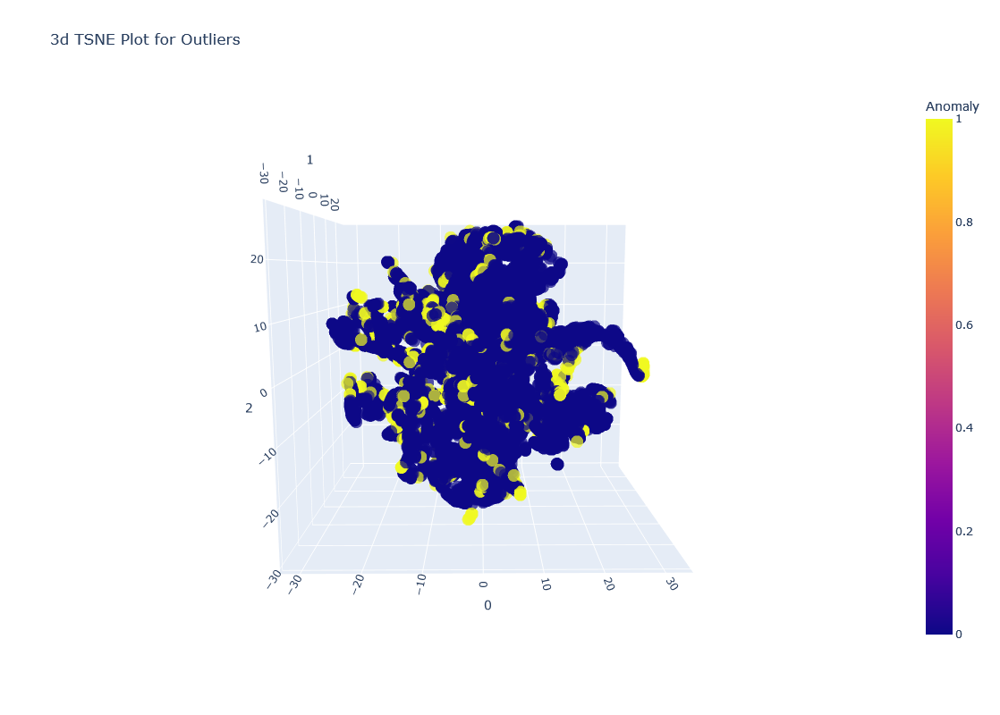

In [43]:
plot_model(lof, plot = 'tsne')

Based on the plot above, it is evident that there is 
- no inherent pattern of where the yellow data points (outliers) are located
- anomalies are scattered randomly across the plot
  
Overall, there does not seem to be any pattern where the anomalies are located.

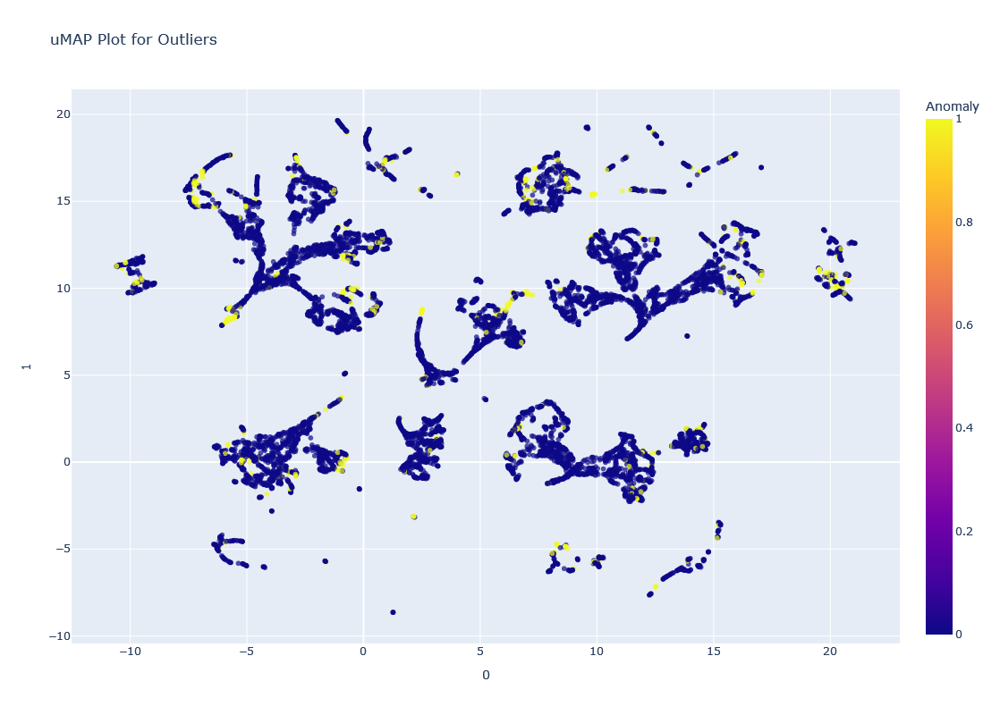

In [44]:
plot_model(lof, plot = 'umap')

From the umap, it is evident that there are:
- distinct clusters of data points
- however, there is more overlapping of yellow (anomalies) and blue data points (non-anomalies) than both the iforest and knn models
- anomaly points seem like they are scattered randomly across each cluster.
  
Overall, the lof model performs relatively worse in detecting anomalies based on the 3d-TSNE and UMAP plots.

**Evaluating pca model**

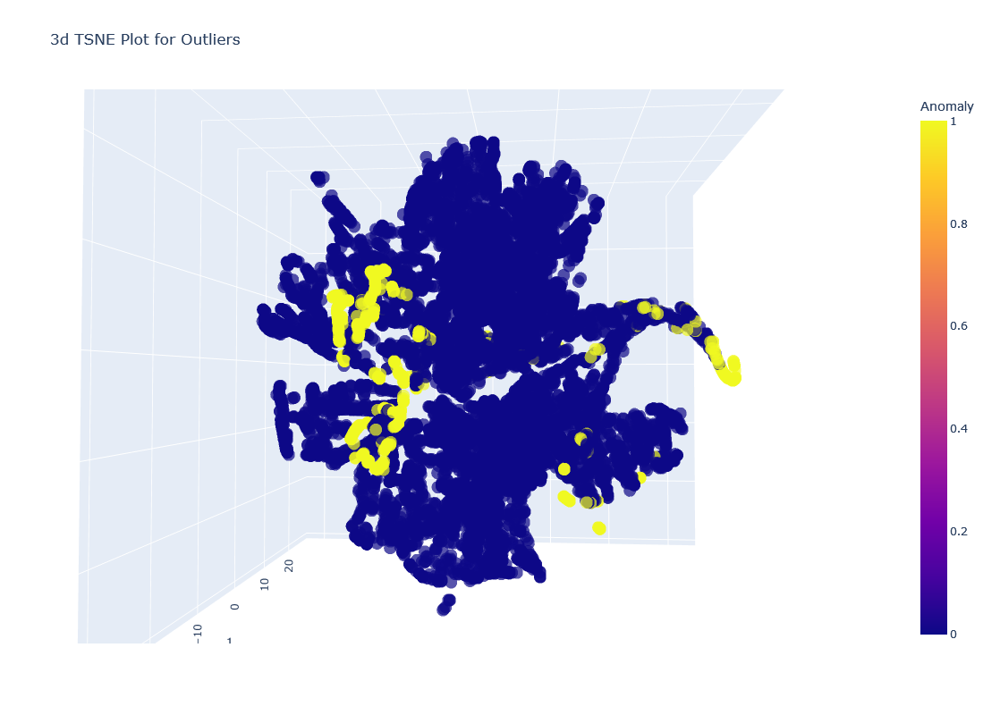

In [45]:
plot_model(pca, plot = 'tsne')

Based on the plot above, you can see that there is:
- a dense cluster (blue) which is sandwiched between the yellow data points (anomalies)
- a smaller stretch of yellow data points (anomalies) exetending outwards to the right
- a cluster of anomaly points that are isolated from the dense cluster on the left
- some overlapping of anomalies and non-anomalies  
  
Overall, there seems to be clusters where the anomalies are located as they are not scattered randomly across the plot.

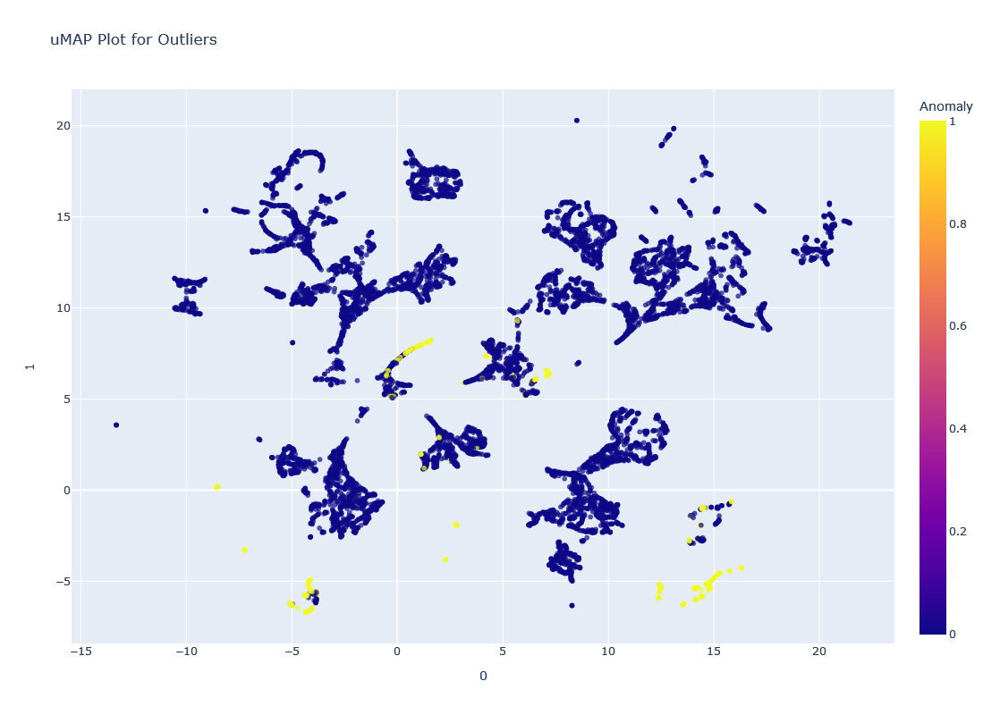

In [46]:
plot_model(pca, plot = 'umap')

From the umap, it is evident that there are:
- distinct clusters of data points
- anomalies (yellow data points) are mostly contained in their own clusters where they do not really mix with the blue data points
- there is low noise present when detecting the anomalies as most data points fall within clear clusters
- detected similar, but less anomalies in the centre of the chart than the knn model
- detected more anomalies at the top and bottom of the chart  
  
Overall, the pca model performs relatively well in detecting anomalies based on the 3d-TSNE and UMAP plots.

**Best model**  
In conclusion, the best model is the knn model as it had a lower rate of overlapping of anomalies and non-anomalies than both the iforest, lof and pca models. Additionally, it consistently predicted the same data points as anomalies when compared against iforest and pca. This in turn demonstrated its ability to replicate the results of these two models. Therefore, it is chosen as the best model.

**Part 4: Generate Predictions on Unseen Data**

In [47]:
preprocessing_pipeline = get_config('pipeline')
preprocessing_pipeline

Pipeline(memory=FastMemory(location=C:\Users\tayjo\AppData\Local\Temp\joblib),
         steps=[('date_feature_extractor',
                 TransformerWrapper(include=['TRANS_DT'],
                                    transformer=ExtractDateTimeFeatures())),
                ('numerical_imputer',
                 TransformerWrapper(include=['FISCAL_YR', 'FISCAL_MTH', 'AMT'],
                                    transformer=SimpleImputer())),
                ('categorical_imputer',
                 TransformerWrapper(includ...
                                                               handle_missing='return_nan',
                                                               mapping=[{'col': 'CAT_DESC',
                                                                         'data_type': dtype('O'),
                                                                         'mapping': Eating Places Restaurants    0
rare                         1
NaN                         -1
dtype: int64}]))),
                ('onehot_encoding',
                 TransformerWrapper(include=['DIV_NAME', 'MERCHANT'],
                                    transformer=OneHotEncoder(cols=['DIV_NAME',
                                                                    'MERCHANT'],
                                                              handle_missing='return_nan',
                                                              use_cat_names=True))),
                ('normalize', TransformerWrapper(transformer=RobustScaler()))])

Load in the preprocessing pipeline. This is needed as the unseen data has to be preprocessed in the same as in the setup function before we can use it to perform predictions. If this is not done, we will encounter errors during the predict_model section.

In [48]:
unseen_df = unseen_df.drop(['DEPT_NAME'],axis=1) #dropping DEPT NAME as it was one of the ignored features
unseen_df.head()

,FISCAL_YR,FISCAL_MTH,DIV_NAME,MERCHANT,CAT_DESC,TRANS_DT,AMT
0,2017,11,Special Needs Programs,AMAZON MKTPLACE PMTS,BOOK STORES,2017-05-20,42.17
1,2018,4,Department of Education,CONFERENCE CENTERS,GOVERNMENT SERVICES-NOT ELSEWHERE CLASSIFIED,2017-10-20,290.00
2,2020,2,Department of Education,REDNER'S WHAREHUSE,Grocery Stores Supermarkets,2019-08-15,25.94
3,2019,5,Department of Education,HYATT REGENCY ORLD CC F And B,Eating Places Restaurants,2018-10-28,30.00
4,2017,9,Department of Education,ACADEMY - CDR,ORGANIZATIONS MEMBERSHIP-NOT ELSEWHERE CLASSIFIED,2017-03-27,347.00


In [49]:
#preprocess the unseen_df in the same way as the setup function first
unseen_processed = preprocessing_pipeline.fit_transform(unseen_df)

In [50]:
#predict on unseen set
unseen_pred = predict_model(knn, data=unseen_df)
unseen_pred

,FISCAL_YR,FISCAL_MTH,DIV_NAME_Special Needs Programs,DIV_NAME_Department of Education,DIV_NAME_rare,MERCHANT_rare,CAT_DESC,TRANS_DT_year,TRANS_DT_month,TRANS_DT_day,AMT,Anomaly,Anomaly_Score
0,-0.666667,0.833333,1.0,-1.0,0.0,0.0,0.0,-0.666667,-0.333333,0.3125,-0.011548,1,1.426890
1,-0.333333,-0.333333,0.0,0.0,0.0,0.0,0.0,-0.666667,0.500000,0.3125,0.999755,0,0.322635
2,0.333333,-0.666667,0.0,0.0,0.0,0.0,0.0,0.000000,0.166667,0.0000,-0.077777,0,0.121593
3,0.000000,-0.166667,0.0,0.0,0.0,0.0,-1.0,-0.333333,0.500000,0.8125,-0.061209,0,0.087856
4,-0.666667,0.500000,0.0,0.0,0.0,0.0,0.0,-0.666667,-0.666667,0.7500,1.232351,0,0.267213
...,...,...,...,...,...,...,...,...,...,...,...,...,...
728,1.000000,-0.500000,0.0,-1.0,1.0,0.0,0.0,0.666667,0.166667,0.8750,0.428466,1,1.452456
729,-0.333333,-0.833333,0.0,0.0,0.0,0.0,0.0,-0.666667,0.000000,0.1875,0.010202,0,0.160492
730,0.666667,1.000000,0.0,-1.0,1.0,0.0,0.0,0.666667,-0.166667,-0.7500,3.688893,1,1.618534
731,0.666667,0.333333,1.0,-1.0,0.0,0.0,0.0,0.666667,-0.833333,-0.4375,0.107157,1,1.503964


**Part 5: Save the entire pipeline**

In [52]:
# save pipeline
save_model(knn, 'knn_pipeline')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('date_feature_extractor',
                  TransformerWrapper(include=['TRANS_DT'],
                                     transformer=ExtractDateTimeFeatures())),
                 ('numerical_imputer',
                  TransformerWrapper(include=['FISCAL_YR', 'FISCAL_MTH', 'AMT'],
                                     transformer=SimpleImputer())),
                 ('categorical_imputer',
                  TransformerWrapper(include=['DIV_NAME', 'MERCHANT',
                                              'CAT_DESC'],
                                     tra...
                  TransformerWrapper(include=['DIV_NAME', 'MERCHANT'],
                                     transformer=OneHotEncoder(cols=['DIV_NAME',
                                                                     'MERCHANT'],
                                                               handle_missing='return_nan',
                                                   